In [1]:
# This notebook have built from this tutorial: https://github.com/bnsreenu/python_for_microscopists/blob/master/330_Detectron2_Instance_3D_EM_Platelet.ipynb
import os

# Setup detectron2 logger
from detectron2.utils.logger import setup_logger
setup_logger()

<Logger detectron2 (DEBUG)>

In [2]:
import torch
torch.cuda.empty_cache()  # Free up unutilized memory

checking the version and if we have cuda available

In [3]:
from src.segmentation.framework_handlers.detectron2_handler import print_version_info

!nvcc --version
print_version_info()

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2024 NVIDIA Corporation
Built on Thu_Mar_28_02:18:24_PDT_2024
Cuda compilation tools, release 12.4, V12.4.131
Build cuda_12.4.r12.4/compiler.34097967_0
torch:  2.3 ; cuda:  12.1
detectron2: 0.6


### Exporting the segments train and test dataset and regeister then to the detectron2 package

Remember!! when loading datasets from segments the images will be saved to the segments folder and the json coco annotations file will be save to the `saving_path` defined

In [7]:
from datetime import datetime

# Get the current date and time of the model training process
current_time = datetime.now().strftime("%d-%m-%Y_%H-%M-%S")
current_time

'15-12-2024_21-33-36'

In [8]:
model = "COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x"
detectron2_models_path = "/home/etaylor/code_projects/thesis/checkpoints/stigmas_segmentation/detectron2"
model_saving_path = os.path.join(detectron2_models_path, model, current_time)
print(model_saving_path)

/home/etaylor/code_projects/thesis/checkpoints/stigmas_segmentation/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/15-12-2024_21-33-36


In [7]:
from src.segmentation.framework_handlers.detectron2_handler import register_and_split_dataset

segments_dataset_name = "etaylor/stigmas_dataset"
release = "v0.2"

train_metadata, train_dataset_dicts, test_metadata, test_dataset_dicts = register_and_split_dataset(
    dataset_name=segments_dataset_name,
    release_version=release,
    train_ratio=0.8,  # 80% for training, 20% for testing
)

print(f"Train dataset: {len(train_dataset_dicts)} samples")
print(f"Test dataset: {len(test_dataset_dicts)} samples")


Initializing dataset...
Preloading all samples. This may take a while...


100%|██████████| 115/115 [00:00<00:00, 273.57it/s]


Initialized dataset with 115 images.
Exporting dataset. This may take a while...


  9%|▊         | 10/115 [00:04<00:51,  2.02it/s]

100%|██████████| 115/115 [00:59<00:00,  1.92it/s]

Exported to ./export_coco-instance_etaylor_stigmas_dataset_v0.2.json. Images in segments/etaylor_stigmas_dataset/v0.2
WARNING [12/31 18:38:15 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.



[12/31 18:38:15 d2.data.datasets.coco]: Loaded 115 images in COCO format from segments/etaylor_stigmas_dataset/annotations/export_coco-instance_etaylor_stigmas_dataset_v0.2.json
Train dataset: 92 samples
Test dataset: 23 samples


plot train samples with annotations

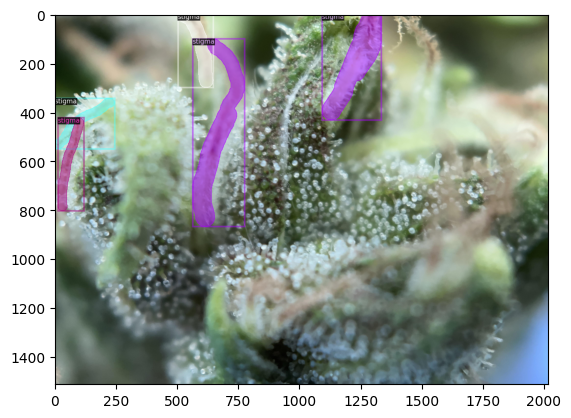

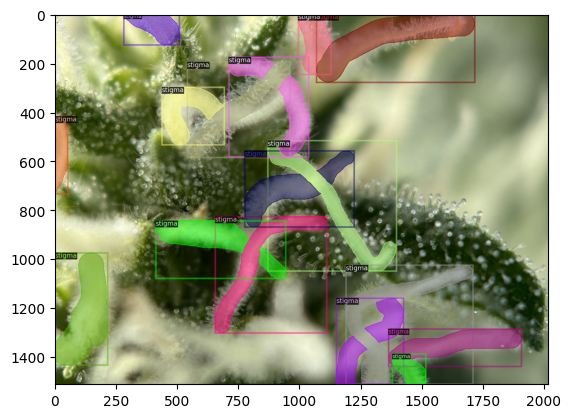

In [10]:
from src.segmentation.framework_handlers.detectron2_handler import plot_train_samples

plot_train_samples(train_dataset_dicts, train_metadata, indices=[10,13])

Define the training params and to which model to fine tune

In [8]:
from detectron2.config import get_cfg
from detectron2.engine import DefaultTrainer
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor

In [12]:
cfg = get_cfg()
cfg.OUTPUT_DIR = model_saving_path
cfg.merge_from_file(model_zoo.get_config_file(f"{model}.yaml"))
cfg.DATASETS.TRAIN = (f"{segments_dataset_name}_train",)
cfg.DATASETS.TEST = (f"{segments_dataset_name}_test",)
cfg.INPUT.MASK_FORMAT = "bitmask"
cfg.DATALOADER.NUM_WORKERS = 4
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url(f"{model}.yaml")  # Let training initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 2  # This is the real "batch size" commonly known to deep learning people
cfg.SOLVER.BASE_LR = 0.00025  # pick a good LR
cfg.SOLVER.MAX_ITER = 1000
cfg.SOLVER.STEPS = []        # do not decay learning rate
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 512   # Default is 512.
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1  # We have 2 classes.
# NOTE: this config means the number of classes, without the background. Do not use num_classes+1 here.

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg) #Create an instance of of DefaultTrainer with the given configuration
trainer.resume_or_load(resume=False) #Load a pretrained model if available (resume training) or start training from scratch if no pretrained model is available


[12/15 21:34:49 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (5, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (5,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in the checkpoint but (16, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (16,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.mask_head.predictor.weight' to the model due to incompatible shapes: (80, 256, 1, 1) in the checkpoint but (4, 256, 1, 1) 

In [13]:
trainer.train() # Start the training process

[12/15 21:34:52 d2.engine.train_loop]: Starting training from iteration 0


/home/etaylor/.conda/envs/detectron_fastai/lib/python3.9/site-packages/detectron2/data/detection_utils.py:446: UserWarning: The given NumPy array is not writable, and PyTorch does not support non-writable tensors. This means writing to this tensor will result in undefined behavior. You may want to copy the array to protect its data or make it writable before converting it to a tensor. This type of warning will be suppressed for the rest of this program. (Triggered internally at ../torch/csrc/utils/tensor_numpy.cpp:206.)
  torch.stack([torch.from_numpy(np.ascontiguousarray(x)) for x in masks])
/home/etaylor/.conda/envs/detectron_fastai/lib/python3.9/site-packages/detectron2/data/detection_utils.py:446: UserWarning: The given NumPy array is not writable, and PyTorch does not support non-writable tensors. This means writing to this tensor will result in undefined behavior. You may want to copy the array to protect its data or make it writable before converting it to a tensor. This type of

[12/15 21:35:20 d2.utils.events]:  eta: 0:07:39  iter: 19  total_loss: 3.192  loss_cls: 1.574  loss_box_reg: 0.2317  loss_mask: 0.6929  loss_rpn_cls: 0.5733  loss_rpn_loc: 0.066    time: 0.6456  last_time: 0.3592  data_time: 0.3748  last_data_time: 0.0030   lr: 4.9953e-06  max_mem: 3007M
[12/15 21:35:37 d2.utils.events]:  eta: 0:08:12  iter: 39  total_loss: 3.142  loss_cls: 1.382  loss_box_reg: 0.2823  loss_mask: 0.6866  loss_rpn_cls: 0.6659  loss_rpn_loc: 0.07298    time: 0.7324  last_time: 0.7290  data_time: 0.4759  last_data_time: 0.4356   lr: 9.9902e-06  max_mem: 3164M
[12/15 21:35:53 d2.utils.events]:  eta: 0:08:02  iter: 59  total_loss: 2.585  loss_cls: 1.077  loss_box_reg: 0.2859  loss_mask: 0.673  loss_rpn_cls: 0.4282  loss_rpn_loc: 0.08056    time: 0.7619  last_time: 1.6176  data_time: 0.4738  last_data_time: 1.2968   lr: 1.4985e-05  max_mem: 3261M
[12/15 21:36:08 d2.utils.events]:  eta: 0:08:27  iter: 79  total_loss: 2.205  loss_cls: 0.7843  loss_box_reg: 0.3568  loss_mask: 0

In [14]:
import yaml
# Save the configuration to a config.yaml file
config_yaml_path = os.path.join(cfg.OUTPUT_DIR, "config.yaml")
print(f"saving config to {config_yaml_path}")
with open(config_yaml_path, 'w') as file:
    yaml.dump(cfg, file)

saving config to /home/etaylor/code_projects/thesis/checkpoints/stigmas_segmentation/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/15-12-2024_21-33-36/config.yaml


In [15]:
cfg.OUTPUT_DIR

'/home/etaylor/code_projects/thesis/checkpoints/stigmas_segmentation/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/15-12-2024_21-33-36'

In [16]:
# Inference should use the config with parameters that are used in training
# cfg now already contains everything we've set previously. We changed it a little bit for inference:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")  # path to the model we just trained
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5   # set a custom testing threshold
predictor = DefaultPredictor(cfg)

[12/15 21:48:12 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /home/etaylor/code_projects/thesis/checkpoints/stigmas_segmentation/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/15-12-2024_21-33-36/model_final.pth ...


### In order to keep playing with the model use `predictor`

Plot model predictions on test set

In [9]:
from src.segmentation.framework_handlers.detectron2_handler import plot_test_predictions

plot_test_predictions(test_dataset_dicts, test_metadata, predictor)

NameError: name 'predictor' is not defined

In [ ]:
import cv2
from matplotlib import pyplot as plt
from detectron2.utils.visualizer import Visualizer, ColorMode

def compare_predictions_and_annotations(dataset_dicts_test, metadata_test, predictor, num_samples=5, scale=0.5):
    """
    Compare model predictions with ground-truth annotations by plotting side-by-side.

    Args:
        dataset_dicts_test (list): Test dataset dictionary.
        metadata_test (Metadata): Metadata for the test dataset.
        predictor (DefaultPredictor): Trained model for making predictions.
        num_samples (int): Number of random samples to compare.
        scale (float): Scale for visualizer.
    """
    for i, d in enumerate(dataset_dicts_test[:num_samples]):
        # Load image
        img = cv2.imread(d["file_name"])

        # Ground truth annotations
        visualizer_gt = Visualizer(img[:, :, ::-1], metadata=metadata_test, scale=scale)
        vis_gt = visualizer_gt.draw_dataset_dict(d)

        # Model predictions
        outputs = predictor(img)
        visualizer_pred = Visualizer(
            img[:, :, ::-1],
            metadata=metadata_test,
            scale=scale,
            instance_mode=ColorMode.IMAGE  # Remove colors for unannotated parts
        )
        vis_pred = visualizer_pred.draw_instance_predictions(outputs["instances"].to("cpu"))

        # Plot side-by-side
        fig, axes = plt.subplots(1, 3, figsize=(20, 8))

        # Original image
        axes[0].imshow(img[:, :, ::-1])
        axes[0].set_title("Original Image")
        axes[0].axis("off")

        # Ground truth
        axes[1].imshow(vis_gt.get_image()[:, :, ::-1])
        axes[1].set_title("Ground Truth Annotations")
        axes[1].axis("off")

        # Predictions
        axes[2].imshow(vis_pred.get_image()[:, :, ::-1])
        axes[2].set_title("Model Predictions")
        axes[2].axis("off")

        plt.tight_layout()
        plt.show()


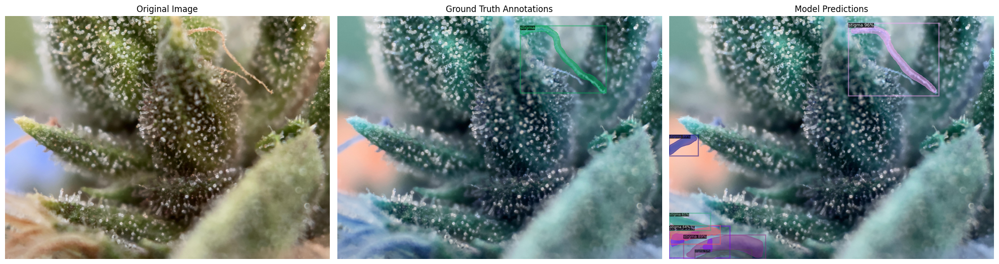

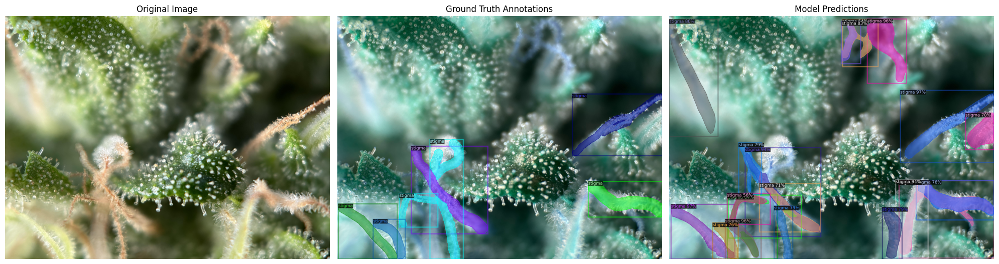

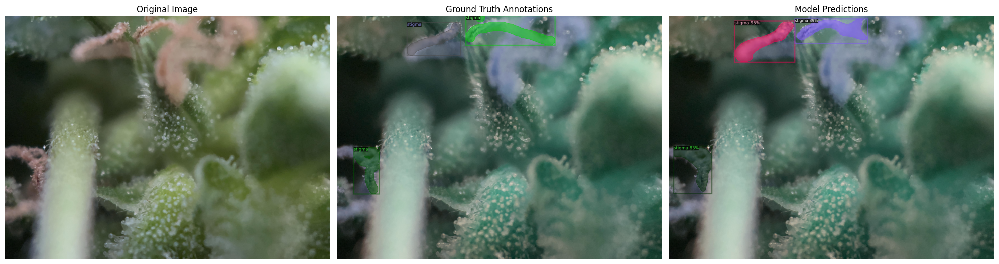

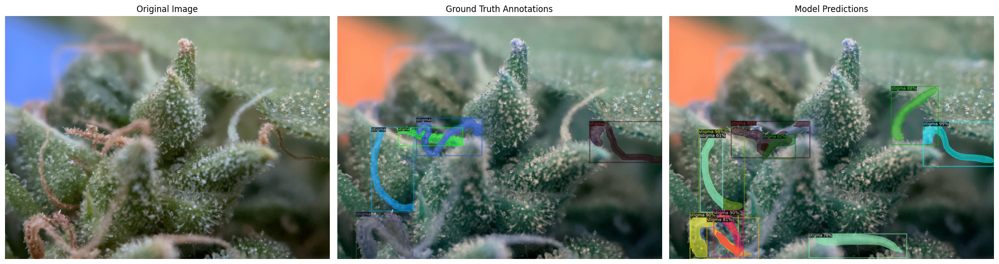

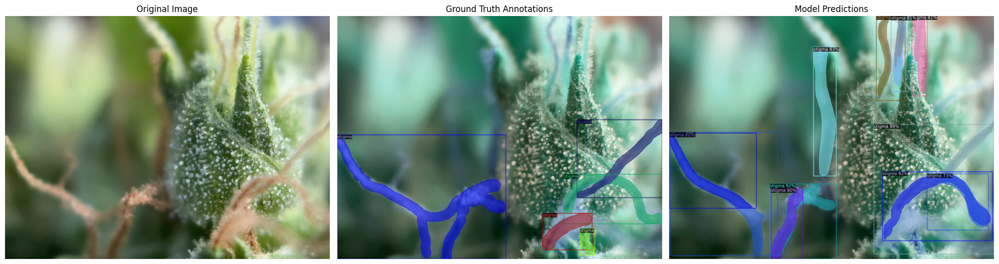

...

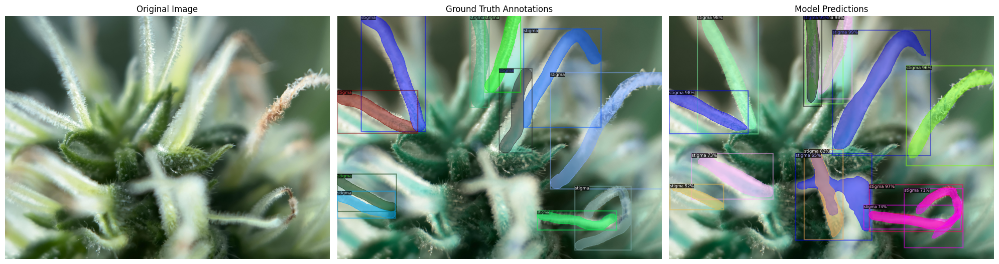

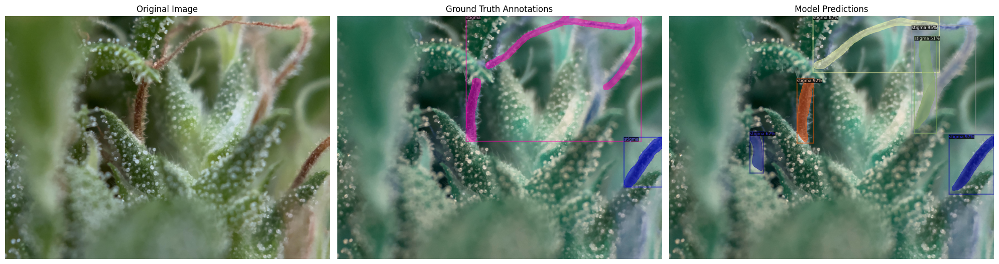

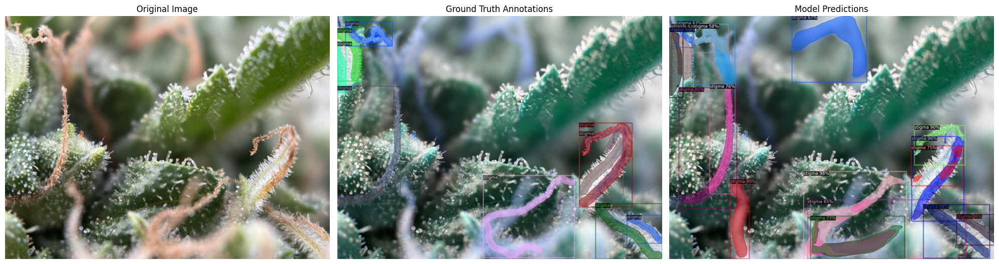

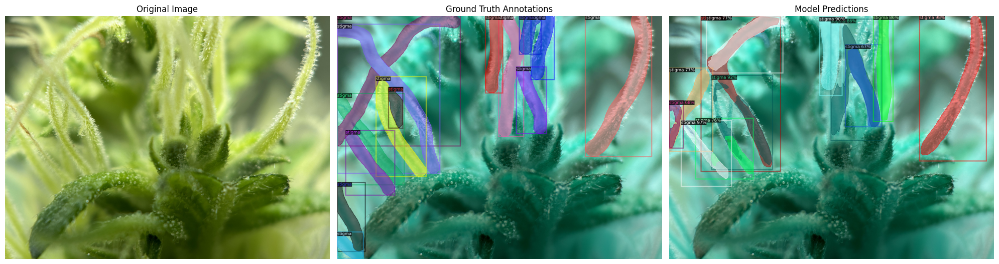

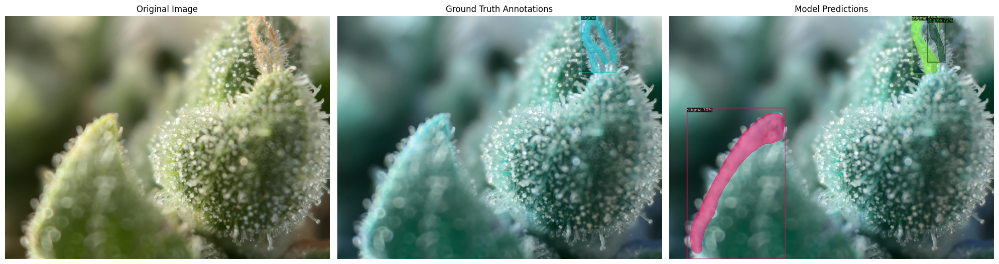

In [19]:
# Compare predictions and annotations for 5 test images
compare_predictions_and_annotations(
    dataset_dicts_test=test_dataset_dicts,
    metadata_test=test_metadata,
    predictor=predictor,
    num_samples=20,
    scale=0.8
)

In [ ]:
import cv2
from matplotlib import pyplot as plt
from detectron2.utils.visualizer import Visualizer

num_samples = 3
scale=0.5

for i, d in enumerate(test_dataset_dicts[:num_samples]):
    img = cv2.imread(d["file_name"])  # Load the image
    visualizer = Visualizer(img[:, :, ::-1], metadata=test_metadata, scale=scale)
    vis = visualizer.draw_dataset_dict(d)  # Draw annotations

    # Display the image
    plt.figure(figsize=(12, 8))
    plt.imshow(vis.get_image()[:, :, ::-1])
    plt.title(f"Test Image {i + 1}")
    plt.axis("off")
    plt.show()

#### Register new test set and evaluate metrics

In [ ]:
# # Register new test set
# from src.segmentation.framework_handlers.detectron2_handler import convert_segments_to_coco_format
# from detectron2.data import DatasetCatalog, MetadataCatalog
# from detectron2.data.datasets import register_coco_instances

# dataset_name_test = "etaylor/cannabis_patches_week9_15_06_2023_3x_regular_IMG_2285"
# release_test = "v0.2"

# # Convert segments dataset to coco format for testing dataset
# _, test_export_json_path, test_saved_images_path = convert_segments_to_coco_format(
#     dataset_name=dataset_name_test, 
#     release_version=release_test, 
# )

# register_coco_instances(dataset_name_test, {}, test_export_json_path, test_saved_images_path)

# metadata_test = MetadataCatalog.get(dataset_name_test)
# dataset_dicts_test = DatasetCatalog.get(dataset_name_test)

Evaluate the performance of the trained model on the test dataset using the `COCOEvaluator`

In [20]:
dataset_name_test = f"{segments_dataset_name}_test"

In [21]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset, DatasetEvaluator
from detectron2.data import build_detection_test_loader
import json

evaluator = COCOEvaluator(dataset_name_test, output_dir=os.path.join(cfg.OUTPUT_DIR, dataset_name_test))
val_loader = build_detection_test_loader(cfg, dataset_name_test)
eval_results = inference_on_dataset(predictor.model, val_loader, evaluator)

# Check if the directory exists
output_dir = os.path.join(cfg.OUTPUT_DIR, os.path.basename(dataset_name_test))
if not os.path.exists(output_dir):
    os.mkdir(output_dir)
    
eval_results_saving_path = os.path.join(cfg.OUTPUT_DIR, os.path.basename(dataset_name_test), "evaluation_results.json")
# Save the eval_results dictionary to a JSON file
with open(eval_results_saving_path, 'w') as file:
    json.dump(eval_results, file, indent=4)

[12/15 21:50:58 d2.evaluation.coco_evaluation]: Fast COCO eval is not built. Falling back to official COCO eval.
[12/15 21:50:58 d2.evaluation.coco_evaluation]: Trying to convert 'etaylor/stigmas_dataset_test' to COCO format ...
[12/15 21:50:58 d2.data.datasets.coco]: Converting annotations of dataset 'etaylor/stigmas_dataset_test' to COCO format ...)
[12/15 21:50:58 d2.data.datasets.coco]: Converting dataset dicts into COCO format
[12/15 21:50:58 d2.data.datasets.coco]: Conversion finished, #images: 23, #annotations: 165
[12/15 21:50:58 d2.data.datasets.coco]: Caching COCO format annotations at '/home/etaylor/code_projects/thesis/checkpoints/stigmas_segmentation/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/15-12-2024_21-33-36/etaylor/stigmas_dataset_test/etaylor/stigmas_dataset_test_coco_format.json' ...
[12/15 21:50:58 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='

In [22]:
print(eval_results)

OrderedDict([('bbox', {'AP': 26.69364416813985, 'AP50': 54.24316109522687, 'AP75': 21.938193713733035, 'APs': nan, 'APm': 0.0, 'APl': 26.856276881457358}), ('segm', {'AP': 11.685353093904721, 'AP50': 36.350924156295235, 'AP75': 1.301779127492581, 'APs': nan, 'APm': 0.0, 'APl': 11.746863811330421})])


#### Segment images and save object level information into a csv file.



In [11]:
from src.segmentation.framework_handlers.detectron2_handler import extract_object_info_to_csv

dataset_directory = "/home/etaylor/code_projects/thesis/segments/etaylor_cannabis_patches_week8_07_06_2023_3x_regular_IMG_1753" 
input_images_directory = os.path.join(dataset_directory, "v0.1")
csv_file_name = "detected_objects.csv"
output_csv_path = os.path.join(dataset_directory,csv_file_name)

extract_object_info_to_csv(input_images_directory, output_csv_path, predictor, metadata_train)

'Object-level information saved to CSV file at /home/etaylor/code_projects/thesis/segments/etaylor_cannabis_patches_week8_07_06_2023_3x_regular_IMG_1753/detected_objects.csv'

In [ ]:
from src.segmentation.framework_handlers.detectron2_handler import plot_class_statistics

plot_class_statistics(output_csv_path, metadata_train)

/tmp/ipykernel_24632/3811209441.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x="Class Name", y="Object Number", data=avg_objects_per_class, ci=None, order=class_names)


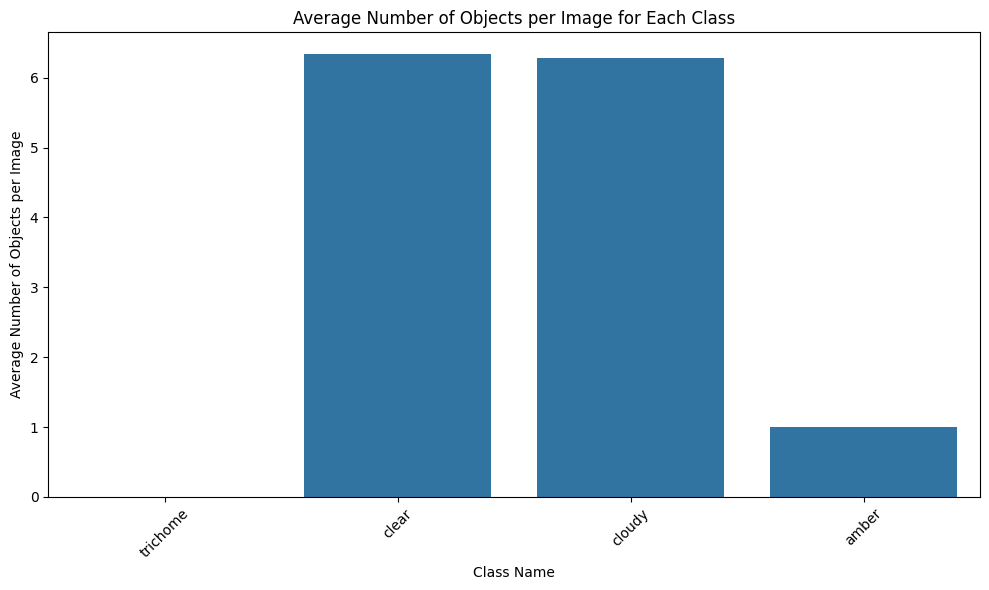

/tmp/ipykernel_24632/3811209441.py:33: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x="Class Name", y="Area", data=avg_area_per_class, ci=None, order=class_names)


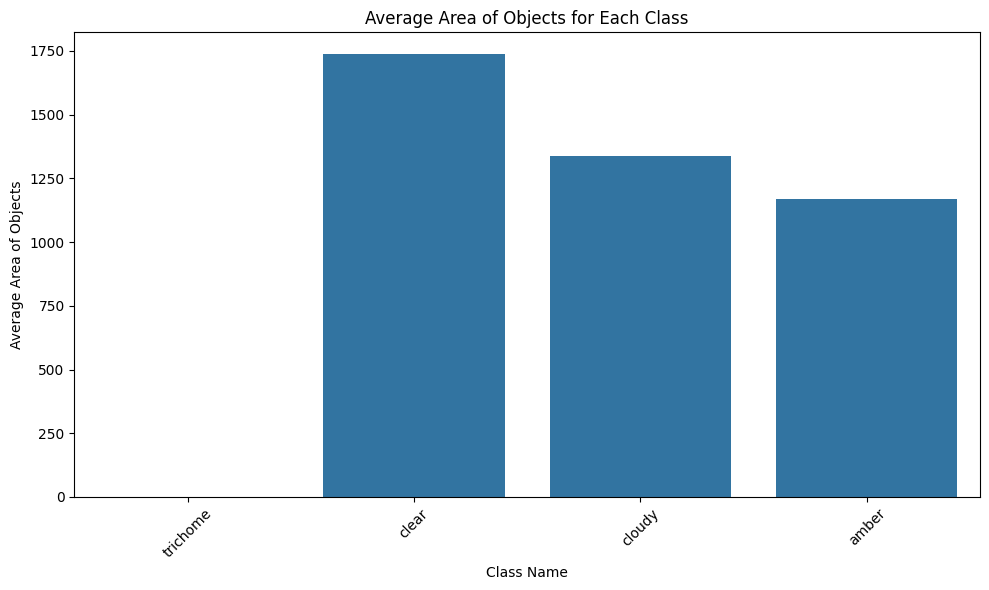

In [12]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Load the CSV file into a pandas DataFrame
df = pd.read_csv(output_csv_path)

# Get class names from train_metadata.thing_classes
class_names = metadata_train.thing_classes

# Group the data by both "File Name" and "Class Name" and calculate the average number of objects per image for each class
# first group the data by both "File Name" and "Class Name" and count the number of objects within each group.
#Then, group the data by "Class Name" only and calculate the mean of the counts, which gives us the average number of objects per image for each class.
avg_objects_per_class = df.groupby(["File Name", "Class Name"])["Object Number"].count().reset_index()
avg_objects_per_class = avg_objects_per_class.groupby("Class Name")["Object Number"].mean().reset_index()

# Plot: Average number of objects per image for each class
plt.figure(figsize=(10, 6))
sns.barplot(x="Class Name", y="Object Number", data=avg_objects_per_class, ci=None, order=class_names)
plt.xticks(rotation=45)
plt.xlabel("Class Name")
plt.ylabel("Average Number of Objects per Image")
plt.title("Average Number of Objects per Image for Each Class")
plt.tight_layout()
plt.show()


# Group the data by class and calculate the average area of objects for each class
avg_area_per_class = df.groupby("Class Name")["Area"].mean().reset_index()

# Plot: Average area of objects for each class
plt.figure(figsize=(10, 6))
sns.barplot(x="Class Name", y="Area", data=avg_area_per_class, ci=None, order=class_names)
plt.xticks(rotation=45)
plt.xlabel("Class Name")
plt.ylabel("Average Area of Objects")
plt.title("Average Area of Objects for Each Class")
plt.tight_layout()
plt.show()
